<a href="https://colab.research.google.com/github/Uemerson/image-registration-tests/blob/main/voxelmorph_fire_fundus.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Install necessary libs

In [1]:
!pip install pillow

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [2]:
# install voxelmorph, which will also install dependencies: neurite and pystrum
!pip install voxelmorph

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 54 kB 2.1 MB/s 
     |████████████████████████████████| 108 kB 15.2 MB/s 


In [3]:
!pip install patchify

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [9]:
!pip install py7zr

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 4.9 MB 6.8 MB/s 
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
    Preparing wheel metadata ... done
     |████████████████████████████████| 131 kB 54.2 MB/s 
     |████████████████████████████████| 2.3 MB 38.3 MB/s 
     |████████████████████████████████| 43 kB 1.8 MB/s 
     |████████████████████████████████| 357 kB 54.0 MB/s 
     |████████████████████████████████| 59 kB 7.0 MB/s 
     |████████████████████████████████| 2.4 MB 49.8 MB/s 
  Created wheel for py7zr: filename=py7zr-0.18.9-py3-none-any.whl size=67806 sha256=44d073261b9ef6a90e3a95c41182286afc23bfb932f304dd53ebd10815090317
  Stored in directory: /root/.cache/pip/wheels/a7/ce/25/7181dbeffbdb3d6b97a37f02deafdddcaa7ec6d5a5c7b0cabc
Successfully built py7zr


# Import necessary libs

In [2]:
# imports
import os, sys
import glob

# third party imports
import numpy as np
%tensorflow_version 2.x
import tensorflow as tf
assert tf.__version__.startswith('2.'), 'This tutorial assumes Tensorflow 2.0+'

# local imports
import voxelmorph as vxm
import neurite as ne

from google.colab import drive
import matplotlib.pyplot as plt  # Just so we can visually confirm we have the same images
%matplotlib inline
from PIL import Image
# from zipfile import ZipFile
import io
import time
from patchify import patchify, unpatchify
import py7zr

#Enabling and testing the GPU

In [5]:
device_name = tf.test.gpu_device_name()
if device_name != '/device:GPU:0':
  raise SystemError('GPU device not found')
print('Found GPU at: {}'.format(device_name))

Found GPU at: /device:GPU:0


# Connect with google drive

In [6]:
# mount drive
drive.mount('/content/gdrive')

Mounted at /content/gdrive


# Images 3D Patchify

## Utils

In [17]:
def dice_coef(y_true, y_pred):
    y_true_f = tf.reshape(tf.dtypes.cast(y_true, tf.float32), [-1])
    y_pred_f = tf.reshape(tf.dtypes.cast(y_pred, tf.float32), [-1])
    intersection = tf.reduce_sum(y_true_f * y_pred_f)
    return (2. * intersection + 1.) / (tf.reduce_sum(y_true_f) + tf.reduce_sum(y_pred_f) + 1.)

In [16]:
def plot_image(image, title):
    # showing image
    plt.imshow(image)
    plt.axis('off')
    plt.title(title)
    plt.show()

In [13]:
import sys
def sizeof_fmt(num, suffix='B'):
    for unit in ['','Ki','Mi','Gi','Ti','Pi','Ei','Zi']:
        if abs(num) < 1024.0:
            return "%3.1f %s%s" % (num, unit, suffix)
        num /= 1024.0
    return "%.1f %s%s" % (num, 'Yi', suffix)

for name, size in sorted(((name, sys.getsizeof(value)) for name, value in locals().items()),
                         key= lambda x: -x[1])[:10]:
    print("{:>30}: {:>8}".format(name, sizeof_fmt(size)))

                       x_train: 12.7 GiB
                           _i9:  1.3 KiB
                           _i8:  1.2 KiB
                           _i2:  589.0 B
                           _ii:  570.0 B
                          _i11:  570.0 B
                          _i13:  505.0 B
                           _i7:  476.0 B
                          _iii:  373.0 B
                          _i10:  373.0 B


## Convert images to numpy arrays (npz)

In [ ]:
colab_dataset_path = "/content/gdrive/My Drive/Colab Notebooks/image-registration/datasets/fire-fundus-image-registration/FIRE.7z"

with py7zr.SevenZipFile(colab_dataset_path, mode='r') as z:
    z.extractall()

images = glob.glob('FIRE/Images/*')
train_images = []

for image in images:
  train_image = Image.open(image)
  # train_image.thumbnail(size, Image.ANTIALIAS)

  # showing image
  # plt.imshow(train_image)
  # plt.axis('off')
  # plt.title("train_image")
  # plt.show()

  # original size: 2912 x 2912 (2912 / 14 = 208)
  patches = patchify(np.array(train_image), (208, 208, 3), step=208)
  
  for i in range(patches.shape[0]):
    for j in range(patches.shape[1]):
      single_patch = patches[i,j,:,:]
      train_images.append(single_patch[0])
      # showing image
      # plt.imshow(single_patch[0])
      # plt.axis('off')
      # plt.title(f"i: {i}, j: {j}")
      # plt.show()

  if image == 'FIRE/Images/S30_2.jpg':
    break

np.savez_compressed("train.npz", train=train_images)

## Load dataset

In [3]:
train = np.load('train.npz')
x_train = train['train']

print('type of x_train: {}'.format(type(x_train)))
print('shape of x_train: {}'.format(x_train.shape))

type of x_train: <class 'numpy.ndarray'>
shape of x_train: (13132, 208, 208, 3)


## VoxelMorph

### Visualize Data

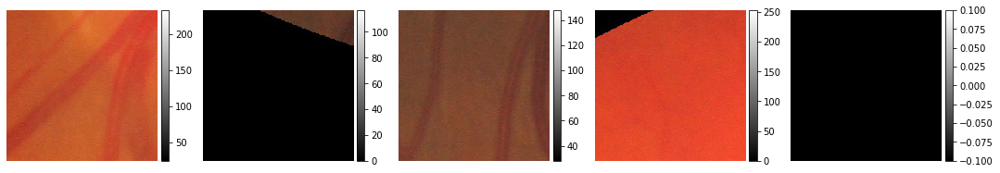

In [4]:
nb_vis = 5

# choose nb_vis sample indexes
idx = np.random.choice(x_train.shape[0], nb_vis, replace=False)
example_images = [f for f in x_train[idx, ...]]

# plot
ne.plot.slices(example_images, cmaps=['gray'], do_colorbars=True);

### Normalized

In [5]:
# fix data
x_train = x_train.astype('float')/255

# verify
print('training maximum value', x_train.max())

training maximum value 1.0


### Re-visualize

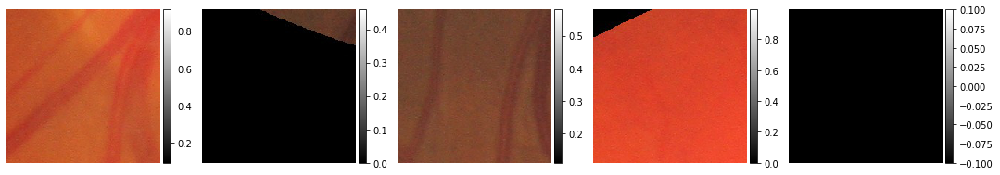

In [6]:
example_images = [f for f in x_train[idx, ...]]
ne.plot.slices(example_images, cmaps=['gray'], do_colorbars=True);

### Prepare model checkpoint save path

In [7]:
# prepare model folder
model_dir = 'checkpoints'
gpu = '0'
os.makedirs(model_dir, exist_ok=True)

# tensorflow device handling
device, nb_devices = vxm.tf.utils.setup_device(gpu)
batch_size=32
assert np.mod(batch_size, nb_devices) == 0, \
    'Batch size (%d) should be a multiple of the nr of gpus (%d)' % (batch_size, nb_devices)

# prepare model checkpoint save path
save_filename = os.path.join(model_dir, '{epoch:04d}.h5')

### CNN Model

In [8]:
initial_epoch=0

# configure unet features (unet architecture)
nb_features = [
    [32, 32, 32, 32],         # encoder features
    [32, 32, 32, 32, 32, 16]  # decoder features
]

# build model using VxmDense
inshape = x_train.shape[1:-1]

vxm_model = vxm.networks.VxmDense(inshape, nb_features, int_steps=7, src_feats=3, trg_feats=3)

print('input shape: ', ', '.join([str(t.shape) for t in vxm_model.inputs]))
print('output shape:', ', '.join([str(t.shape) for t in vxm_model.outputs]))

# voxelmorph has a variety of custom loss classes
losses = [vxm.losses.MSE().loss, vxm.losses.Grad('l2').loss]

# usually, we have to balance the two losses by a hyper-parameter
lambda_param = 0.05
loss_weights = [1, lambda_param]

# multi-gpu support
if nb_devices > 1:
    save_callback = vxm.networks.ModelCheckpointParallel(save_filename)
    model = tf.keras.utils.multi_gpu_model(vxm_model, gpus=nb_devices)
else:
    save_callback = tf.keras.callbacks.ModelCheckpoint(save_filename, period=20)

vxm_model.compile(optimizer='Adam', loss=losses, loss_weights=loss_weights)

# save starting weights
vxm_model.save(save_filename.format(epoch=initial_epoch))

input shape:  (None, 208, 208, 3), (None, 208, 208, 3)
output shape: (None, 208, 208, 3), (None, 104, 104, 2)


### Train Model

In [9]:
def vxm_data_generator(x_data, batch_size=32):
    """
    Generator that takes in data of size [N, H, W], and yields data for
    our custom vxm model. Note that we need to provide numpy data for each
    input, and each output.

    inputs:  moving [bs, H, W, 1], fixed image [bs, H, W, 1]
    outputs: moved image [bs, H, W, 1], zero-gradient [bs, H, W, 2]
    """

    # preliminary sizing
    vol_shape = x_data.shape[1:] # extract data shape
    ndims = len(vol_shape)
    
    # prepare a zero array the size of the deformation
    # we'll explain this below
    zero_phi = np.zeros([batch_size, *vol_shape])
    
    while True:
        # prepare inputs:
        # images need to be of the size [batch_size, H, W, 1]
        idx1 = np.random.randint(0, x_data.shape[0], size=batch_size)
        moving_images = x_data[idx1, ...]
        idx2 = np.random.randint(0, x_data.shape[0], size=batch_size)
        fixed_images = x_data[idx2, ...]
        inputs = [moving_images, fixed_images]
        
        # prepare outputs (the 'true' moved image):
        # of course, we don't have this, but we know we want to compare 
        # the resulting moved image with the fixed image. 
        # we also wish to penalize the deformation field. 
        outputs = [fixed_images, zero_phi]
        
        yield (inputs, outputs)

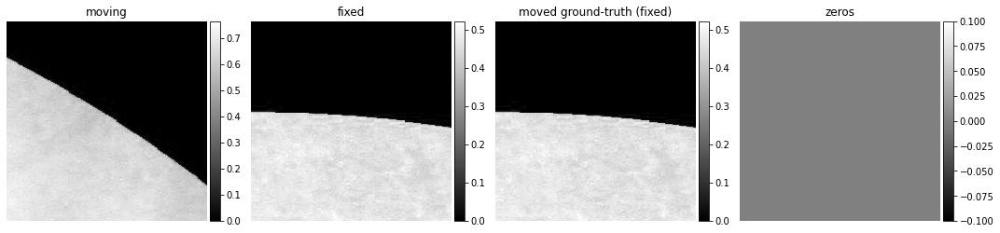

In [10]:
# let's test it
train_generator = vxm_data_generator(x_train)
in_sample, out_sample = next(train_generator)

# visualize
images = [img[0, :, :, 0] for img in in_sample + out_sample] 
titles = ['moving', 'fixed', 'moved ground-truth (fixed)', 'zeros']
ne.plot.slices(images, titles=titles, cmaps=['gray'], do_colorbars=True);

In [11]:
nb_epochs = 100
steps_per_epoch = 100
with tf.device('/device:GPU:0'):
  hist = vxm_model.fit_generator(train_generator, 
                                 epochs=nb_epochs, 
                                 initial_epoch=initial_epoch,
                                 steps_per_epoch=steps_per_epoch, 
                                 verbose=2, 
                                 callbacks=[save_callback]);
vxm_model.save(os.path.join(model_dir, f'epochs-{nb_epochs}-steps_per_epoch{steps_per_epoch}-batch_size-32.h5'))

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:9: UserWarning: `Model.fit_generator` is deprecated and will be removed in a future version. Please use `Model.fit`, which supports generators.
  if __name__ == '__main__':


Epoch 1/100
100/100 - 98s - loss: 0.0861 - vxm_dense_transformer_loss: 0.0859 - vxm_dense_flow_resize_loss: 0.0036 - 98s/epoch - 977ms/step
Epoch 2/100
100/100 - 68s - loss: 0.0848 - vxm_dense_transformer_loss: 0.0837 - vxm_dense_flow_resize_loss: 0.0204 - 68s/epoch - 680ms/step
Epoch 3/100
100/100 - 68s - loss: 0.0859 - vxm_dense_transformer_loss: 0.0845 - vxm_dense_flow_resize_loss: 0.0268 - 68s/epoch - 676ms/step
Epoch 4/100
100/100 - 67s - loss: 0.0811 - vxm_dense_transformer_loss: 0.0795 - vxm_dense_flow_resize_loss: 0.0319 - 67s/epoch - 675ms/step
Epoch 5/100
100/100 - 68s - loss: 0.0842 - vxm_dense_transformer_loss: 0.0825 - vxm_dense_flow_resize_loss: 0.0350 - 68s/epoch - 679ms/step
Epoch 6/100
100/100 - 67s - loss: 0.0849 - vxm_dense_transformer_loss: 0.0831 - vxm_dense_flow_resize_loss: 0.0364 - 67s/epoch - 673ms/step
Epoch 7/100
100/100 - 67s - loss: 0.0818 - vxm_dense_transformer_loss: 0.0800 - vxm_dense_flow_resize_loss: 0.0363 - 67s/epoch - 674ms/step
Epoch 8/100
100/100 

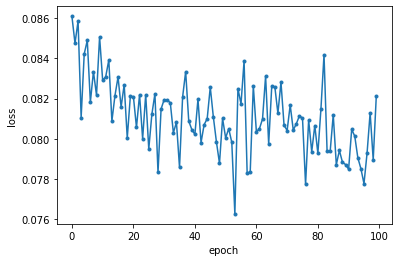

In [12]:
import matplotlib.pyplot as plt

def plot_history(hist, loss_name='loss'):
    # Simple function to plot training history.
    plt.figure()
    plt.plot(hist.epoch, hist.history[loss_name], '.-')
    plt.ylabel('loss')
    plt.xlabel('epoch')
    plt.show()

plot_history(hist)

### Registration

Reg Time (Total): 14.5213
Dice Similarity: 0.3596065938472748


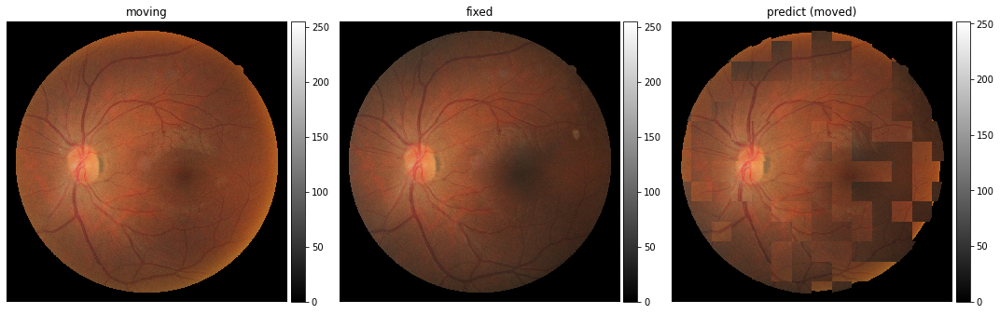


Reg Time (Total): 14.6817
Dice Similarity: 0.3491255044937134


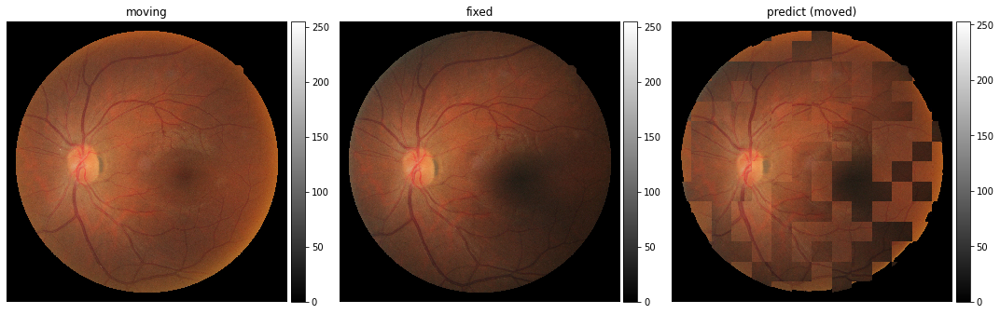


Reg Time (Total): 14.6334
Dice Similarity: 0.3075614273548126


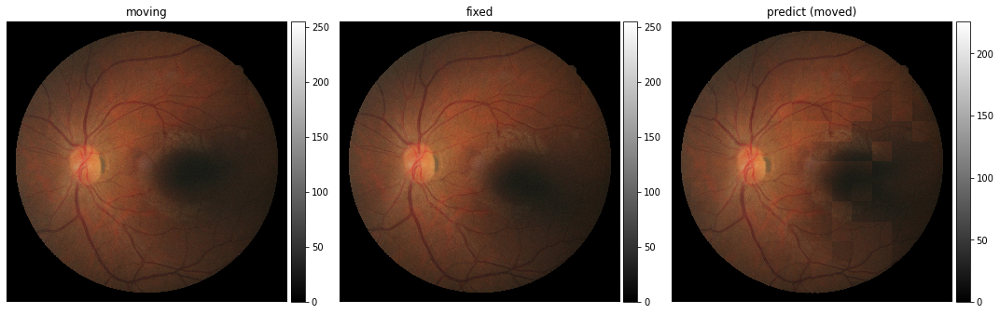


Reg Time (Total): 14.5191
Dice Similarity: 0.3980824947357178


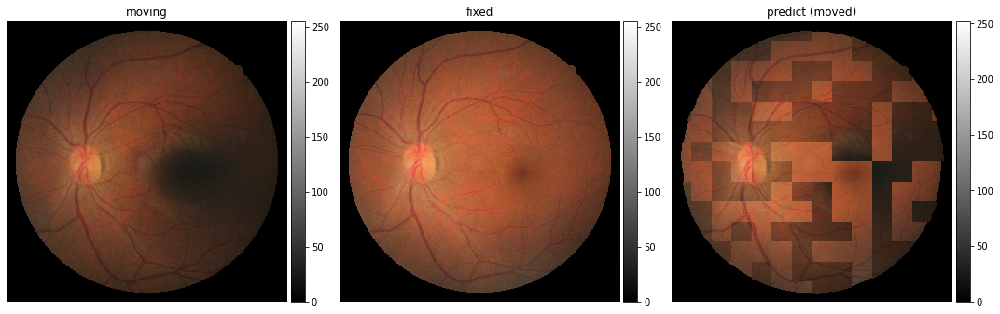


Reg Time (Total): 14.1785
Dice Similarity: 0.3384725749492645


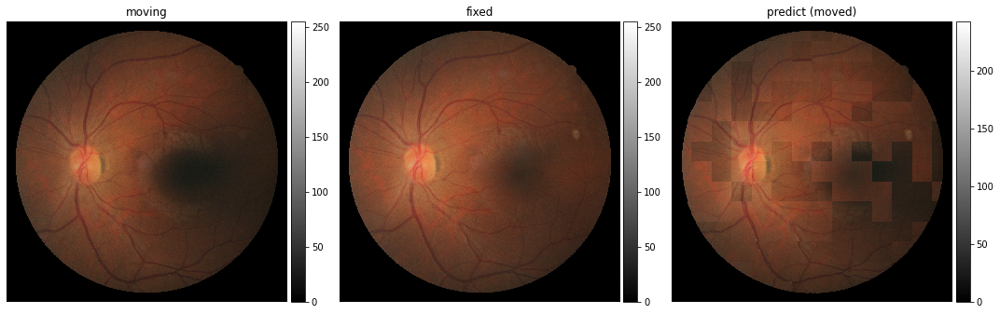


Reg Time (Total): 14.2708
Dice Similarity: 0.33092212677001953


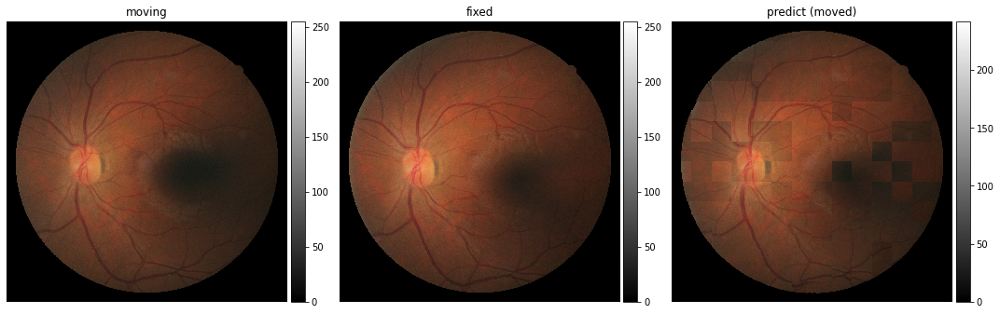


Reg Time (Total): 14.5978
Dice Similarity: 0.4058372676372528


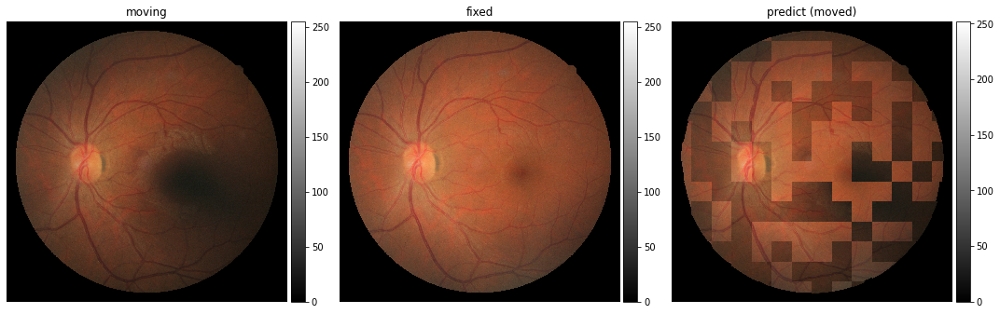


Reg Time (Total): 14.1157
Dice Similarity: 0.3370368480682373


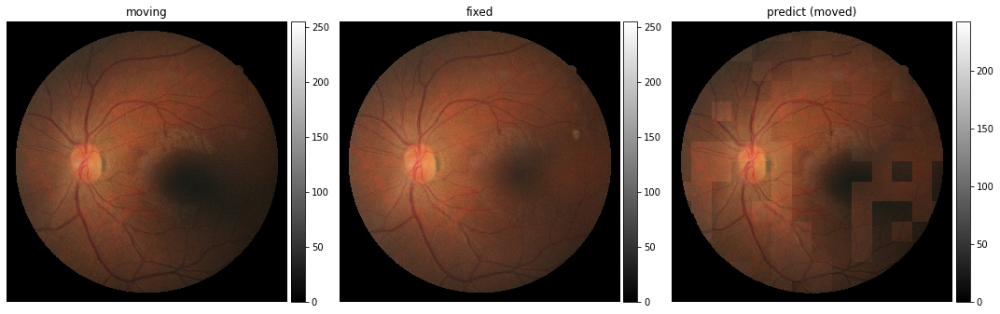


Reg Time (Total): 14.9269
Dice Similarity: 0.33248263597488403


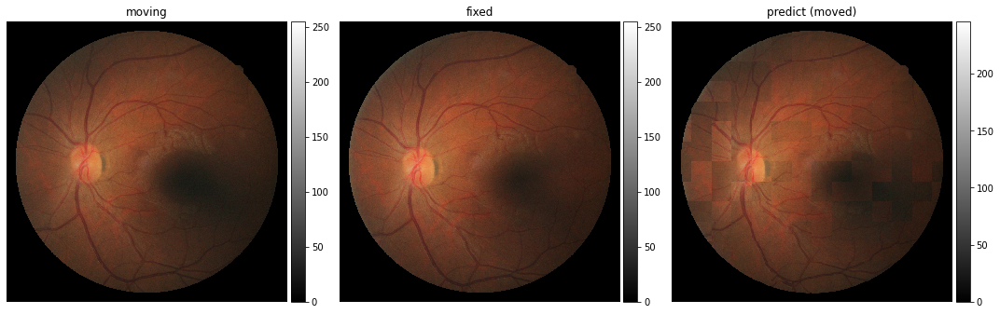


Reg Time (Total): 13.9876
Dice Similarity: 0.3710794448852539


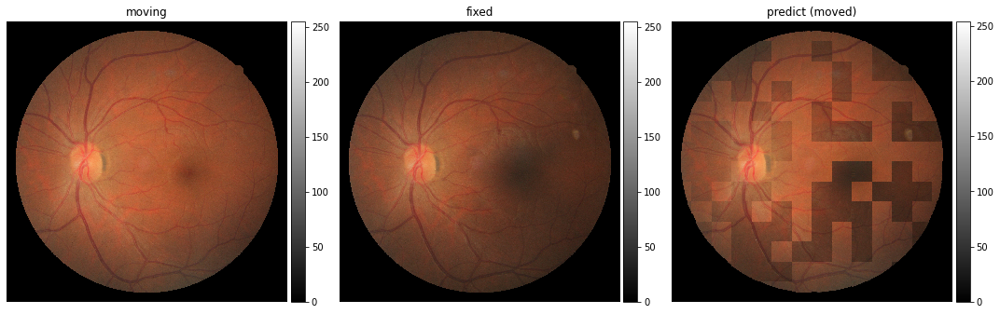


Reg Time (Total): 14.7967
Dice Similarity: 0.3631264865398407


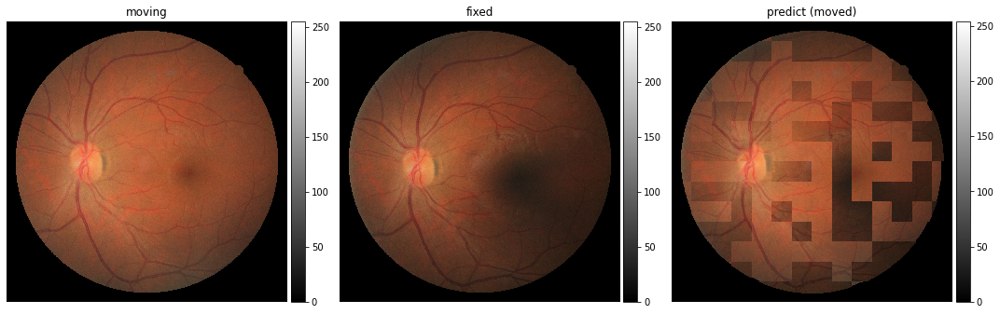


Reg Time (Total): 14.1215
Dice Similarity: 0.34183165431022644


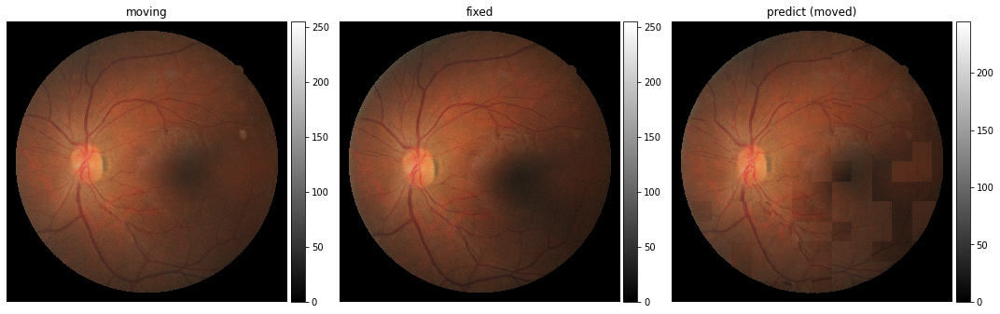


Reg Time (Total): 14.1797
Dice Similarity: 0.6491490602493286


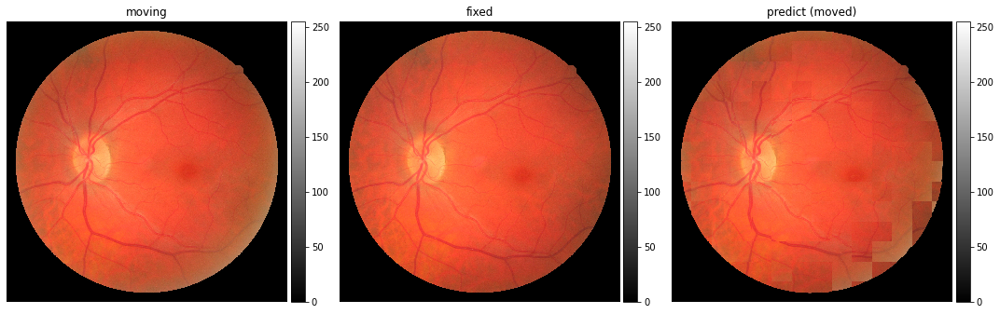


Reg Time (Total): 14.0894
Dice Similarity: 0.635536253452301


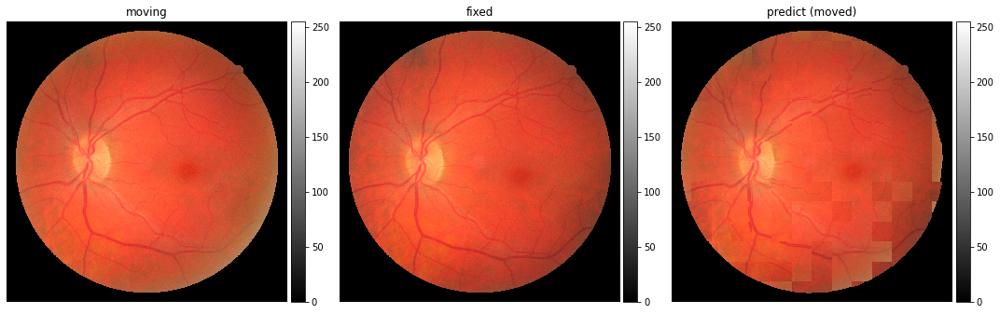


Reg Time (Total): 14.2058
Dice Similarity: 0.6392573118209839


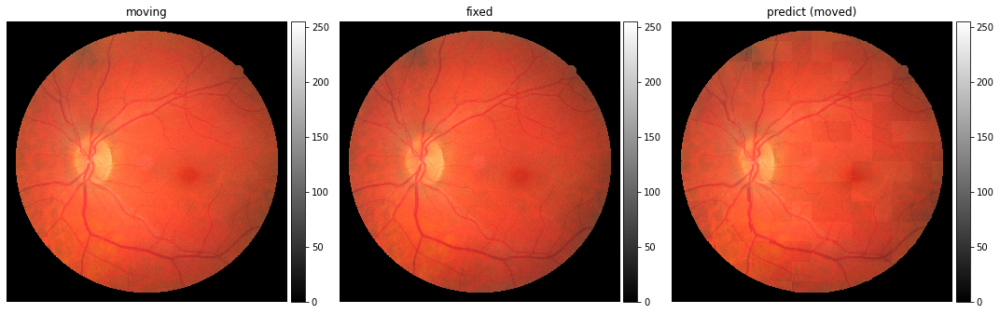


Reg Time (Total): 14.2012
Dice Similarity: 0.5369495749473572


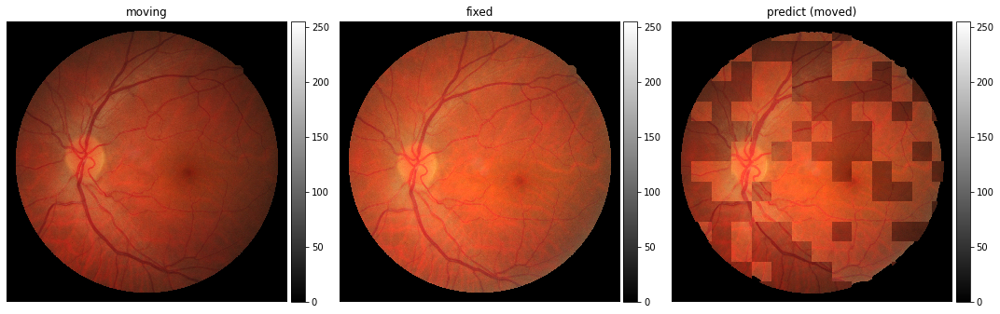


Reg Time (Total): 14.4662
Dice Similarity: 0.6116774678230286


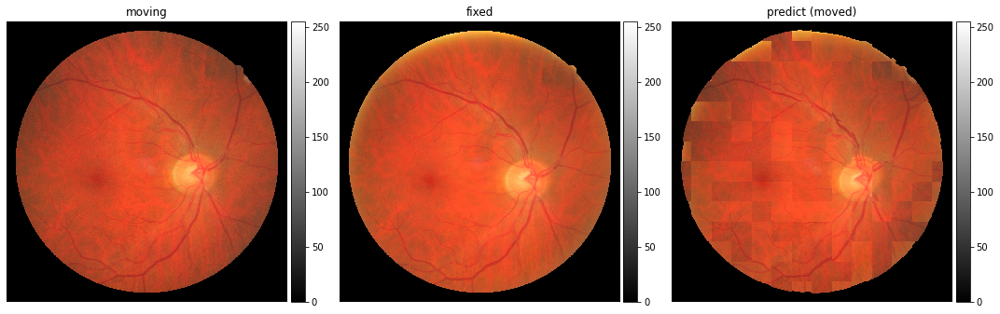


Reg Time (Total): 14.0985
Dice Similarity: 0.6144247651100159


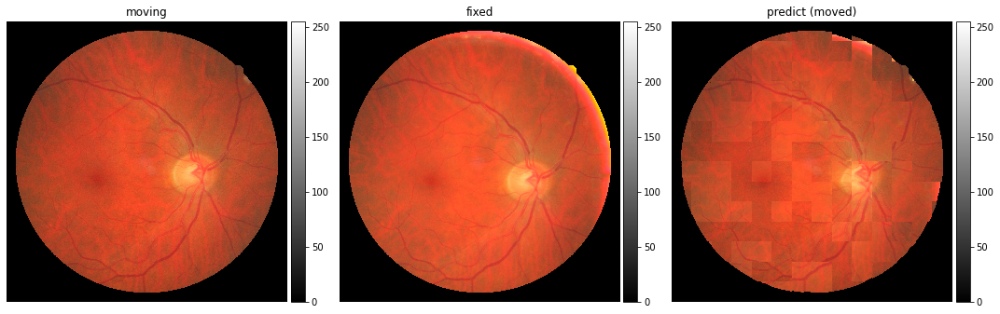


Reg Time (Total): 14.0324
Dice Similarity: 0.609162449836731


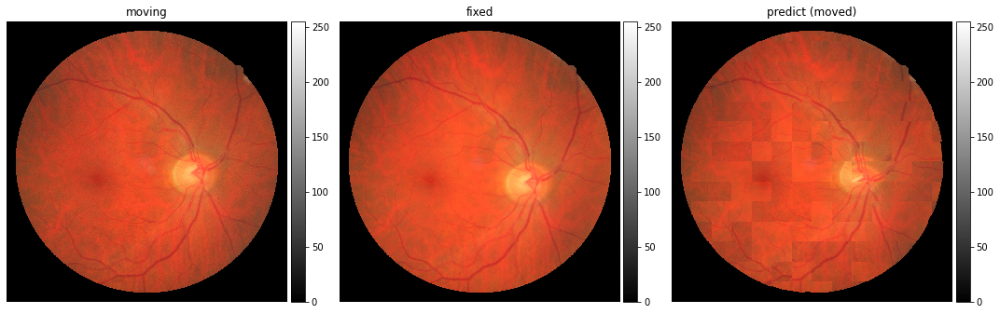


Reg Time (Total): 14.1577
Dice Similarity: 0.6303879022598267


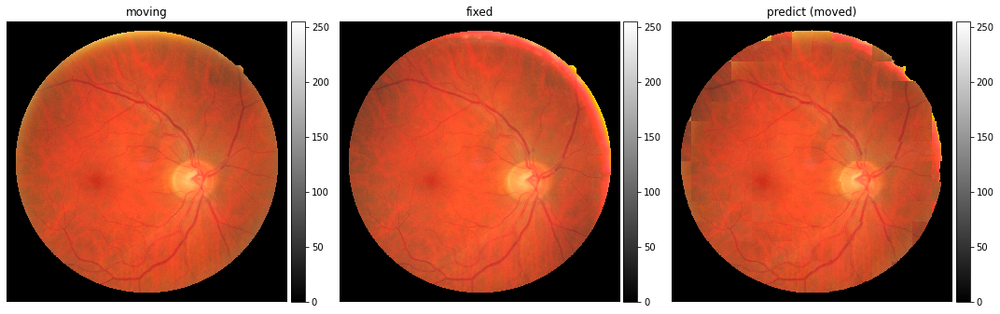


Reg Time (Total): 14.0422
Dice Similarity: 0.6209276914596558


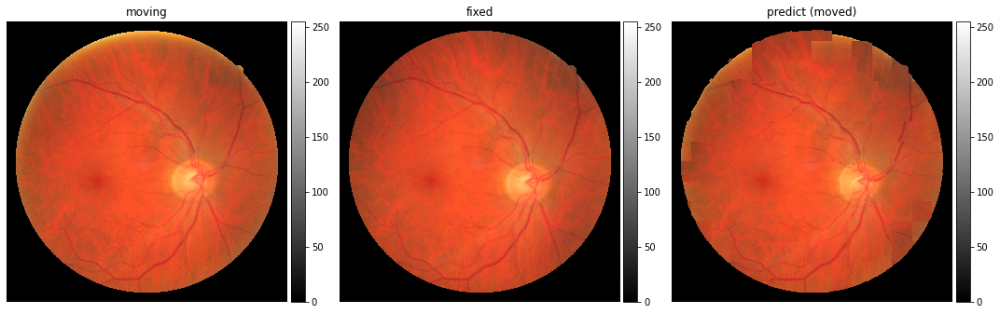


Reg Time (Total): 14.0257
Dice Similarity: 0.6216904520988464


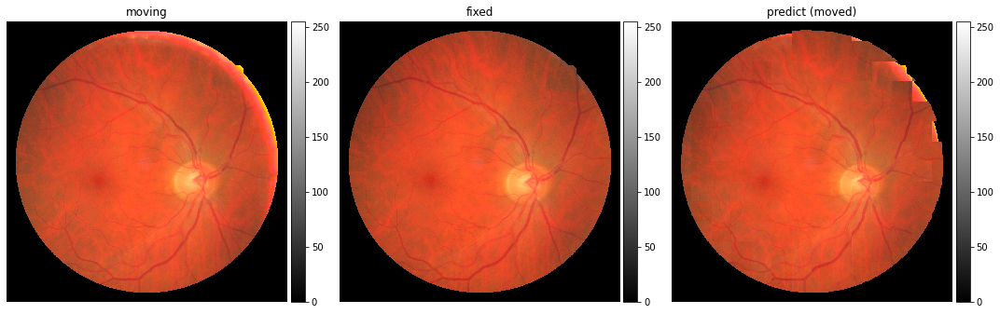


Reg Time (Total): 14.0879
Dice Similarity: 0.45471227169036865


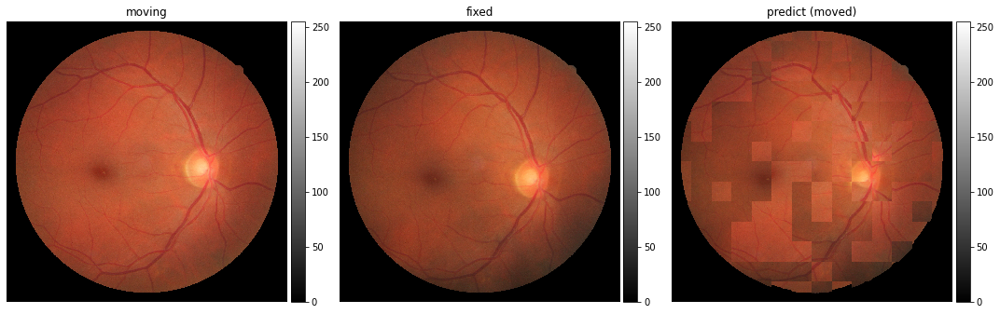


Reg Time (Total): 14.7302
Dice Similarity: 0.5381497740745544


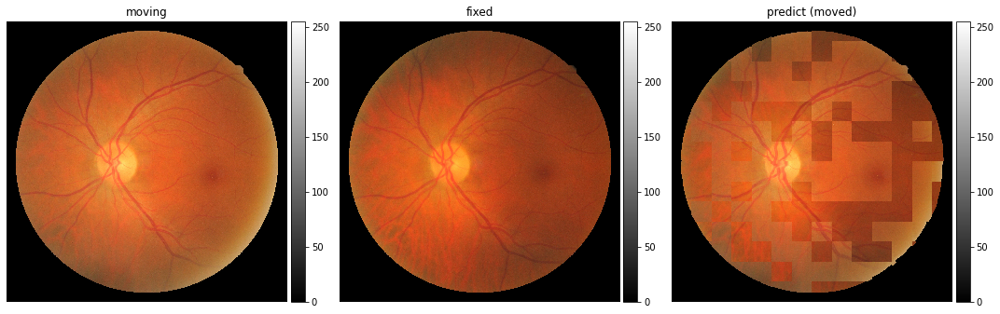


Reg Time (Total): 14.7984
Dice Similarity: 0.5660266876220703


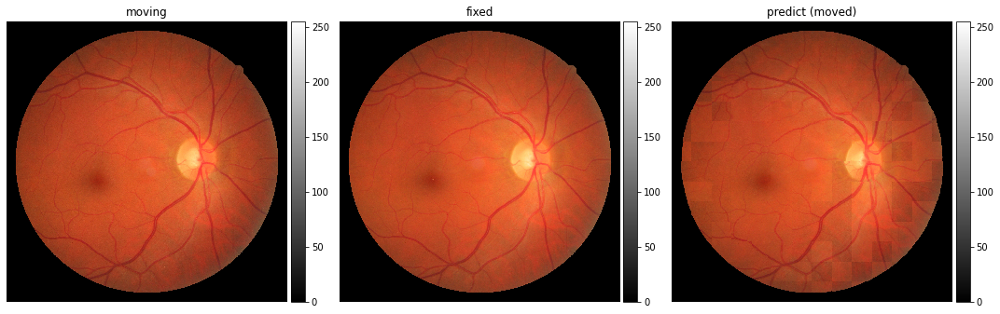


Reg Time (Total): 14.7241
Dice Similarity: 0.5698449611663818


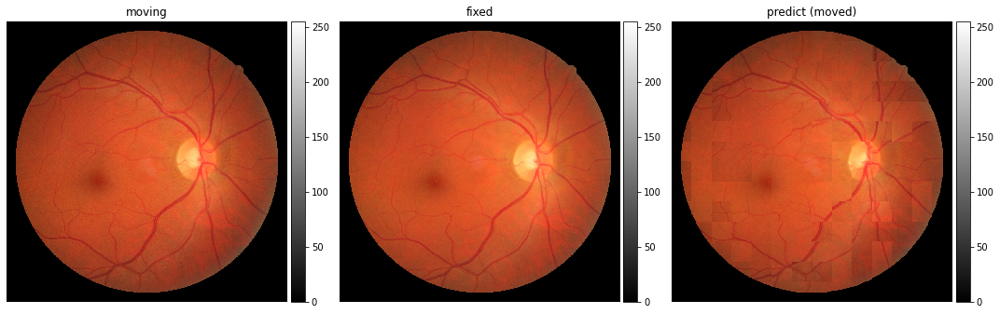


Reg Time (Total): 14.6613
Dice Similarity: 0.5762214660644531


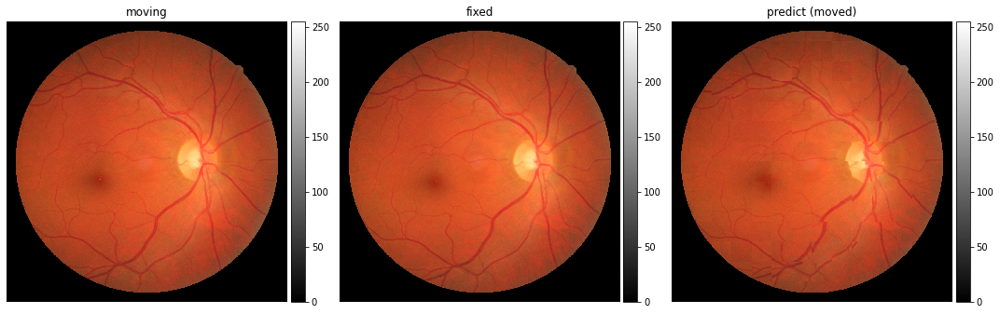


Reg Time (Total): 14.5091
Dice Similarity: 0.5575906038284302


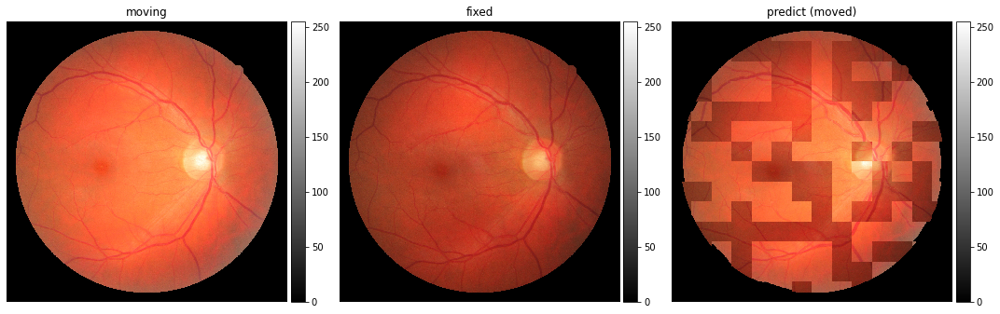


Reg Time (Total): 14.3241
Dice Similarity: 0.540996253490448


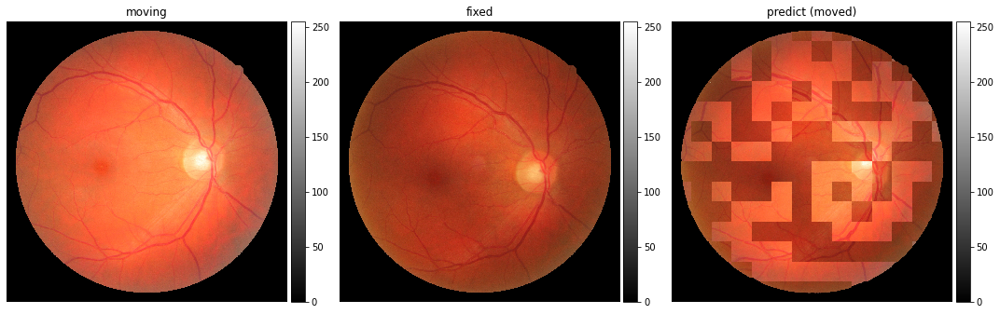


Reg Time (Total): 14.0437
Dice Similarity: 0.513055145740509


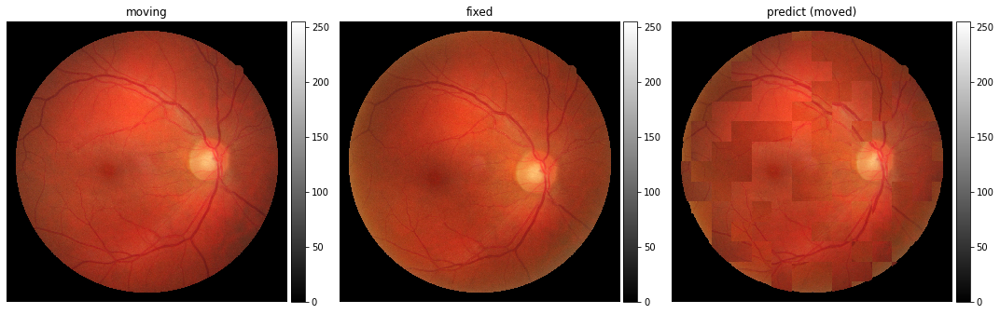


Reg Time (Total): 14.0418
Dice Similarity: 0.6222289204597473


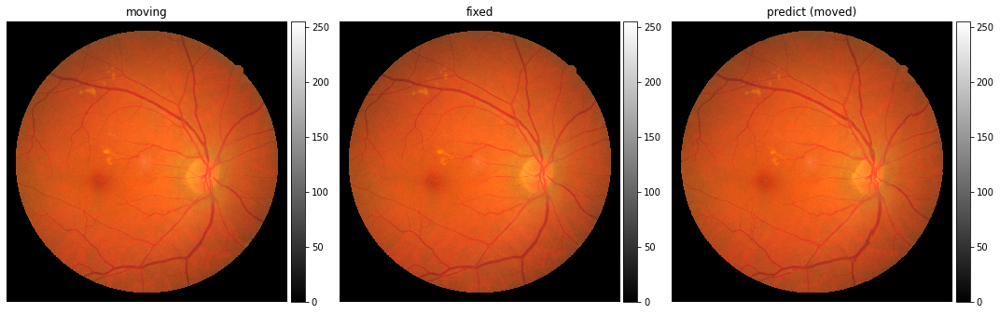


Reg Time (Total): 14.1918
Dice Similarity: 0.5622060298919678


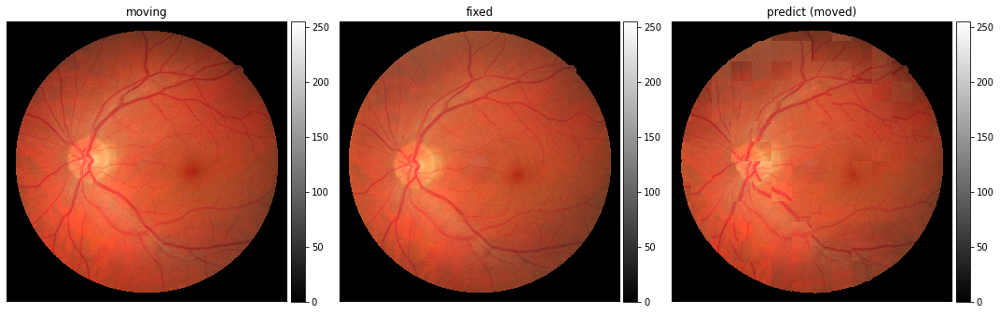


Reg Time (Total): 13.8846
Dice Similarity: 0.5328425765037537


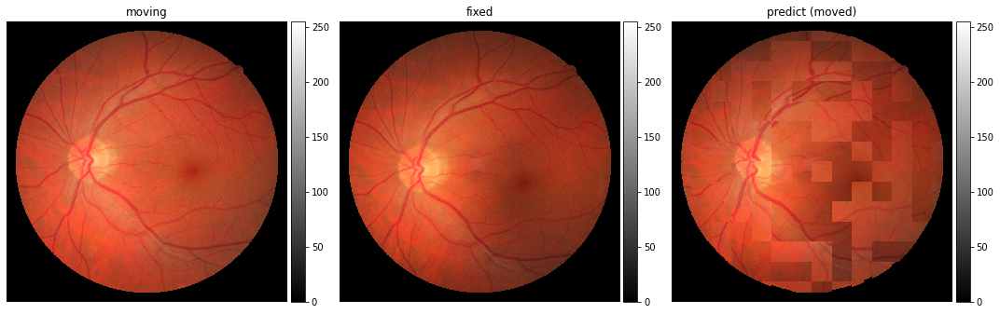


Reg Time (Total): 13.8848
Dice Similarity: 0.5296182632446289


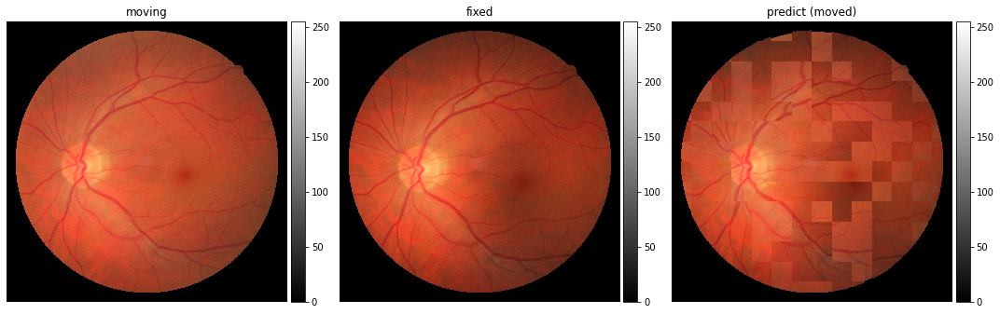


Reg Time (Total): 13.8666
Dice Similarity: 0.5052559971809387


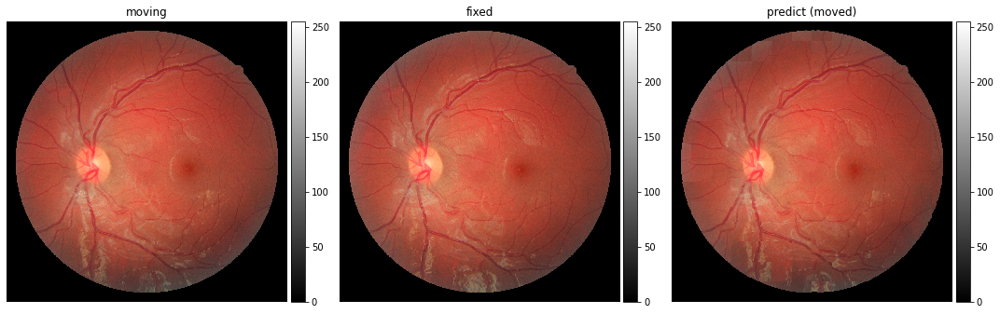


Reg Time (Total): 13.9077
Dice Similarity: 0.59400475025177


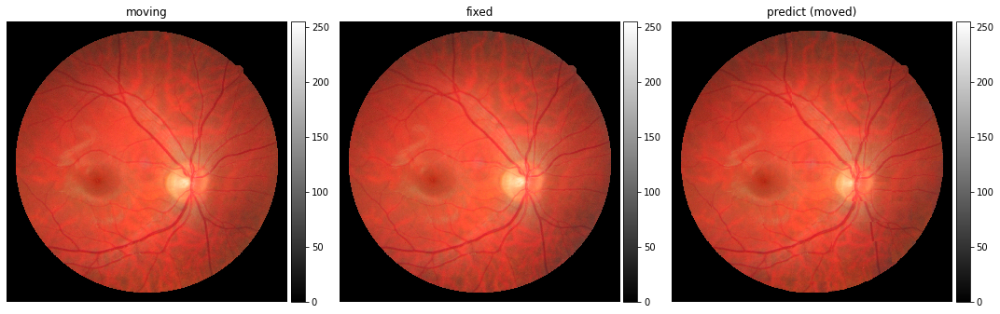


Reg Time (Total): 13.9025
Dice Similarity: 0.6062377095222473


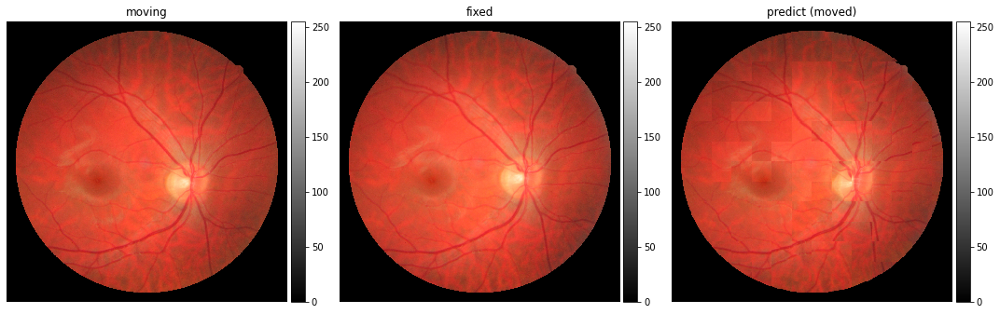


Reg Time (Total): 13.7931
Dice Similarity: 0.6086574792861938


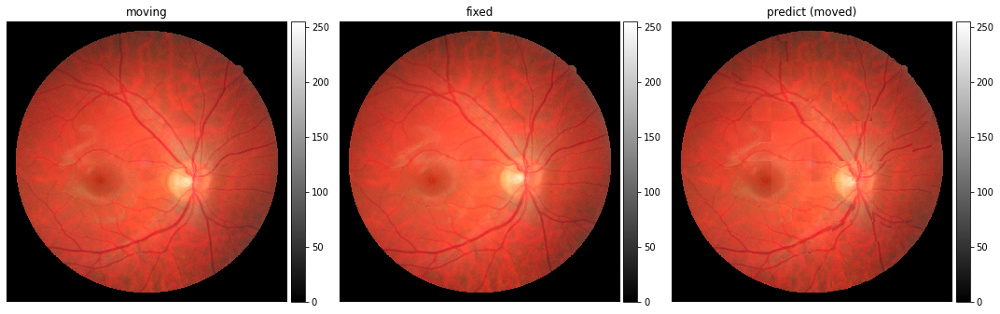


Reg Time (Total): 13.7894
Dice Similarity: 0.5991690158843994


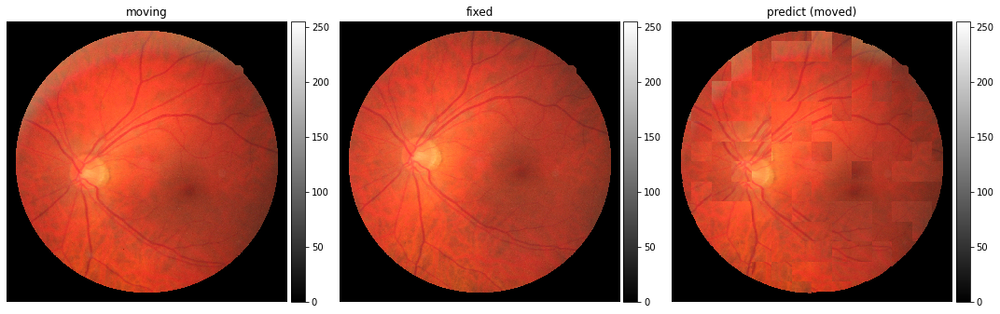


Reg Time (Total): 14.2094
Dice Similarity: 0.6026796698570251


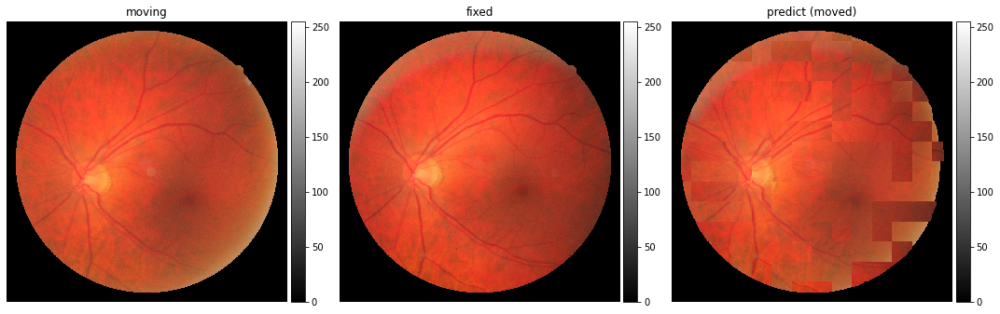


Reg Time (Total): 14.0966
Dice Similarity: 0.595816433429718


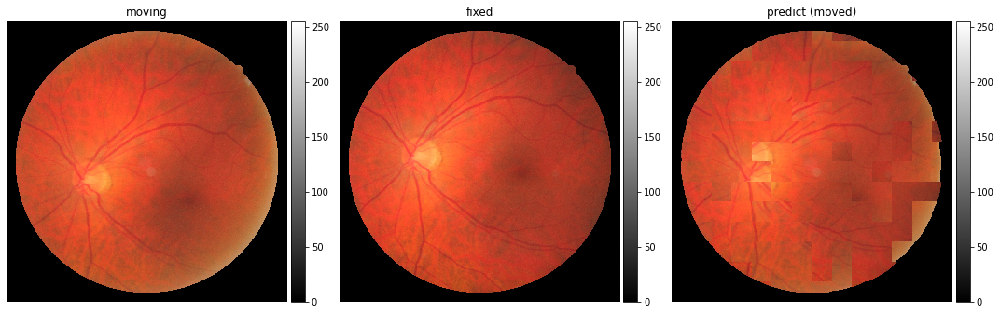

In [27]:
for i in range(31, 72):
  patches_moved = []
  reg_time_total = 0

  # moving
  val_image_moving = Image.open(f"FIRE/Images/S{i}_1.jpg")
  patches_moving = patchify(np.array(val_image_moving), (208, 208, 3), step=208)
  # plot_image(val_image_moving, "moving")

  # fixed
  val_image_fixed = Image.open(f"FIRE/Images/S{i}_2.jpg")
  patches_fixed = patchify(np.array(val_image_fixed), (208, 208, 3), step=208)
  # plot_image(val_image_fixed, "fixed")

  for i in range(patches_moving.shape[0]):
    for j in range(patches_moving.shape[1]):
      single_patch_moving = patches_moving[i,j,:,:]
      single_patch_fixed = patches_fixed[i,j,:,:]

      np.savez("val.npz", val=[single_patch_moving[0], single_patch_fixed[0]])
      val = np.load('val.npz')
      x_val = val['val']
      # fix data
      x_val = x_val.astype('float')/255
      with tf.device(device):
        # let's get some data
        val_generator = vxm_data_generator(x_val, batch_size = 1)
        val_input, _ = next(val_generator)

        # predict warp and time
        start = time.time()
        val_pred = vxm_model.predict(val_input)
        reg_time = time.time() - start

        # visualize colored
        moving_colored = val_input[0][0]
        fixed_colored = val_input[1][0]
        moved_colored = val_pred[0][0]

        # plot flow
        # ne.plot.flow([val_pred[1].squeeze()], width=3);

        # print (f'Reg Time {i}, {j}: {reg_time:.4f}')
        reg_time_total = reg_time_total + reg_time

        patches_moved.append(np.expand_dims(moved_colored, axis=0))

  patches_moved = (np.array(patches_moved)*255).astype(np.uint8)
  patches_moved = np.reshape(patches_moved, 
                              (patches_fixed.shape[0], 
                              patches_fixed.shape[1], 
                              patches_fixed.shape[2], 
                              patches_fixed.shape[3], 
                              patches_fixed.shape[4], 
                              patches_fixed.shape[5]))
  moved_unpatchify = unpatchify(patches_moved, np.array(val_image_fixed).shape)
  # plot_image(moved_unpatchify, "predict (moved)")

  # save predict image
  im = Image.fromarray(moved_unpatchify).convert('RGB')
  im.save("moved_unpatchify.jpeg")

  # total registration time
  print('Reg Time (Total): %.4f' % reg_time_total)

  # compute volume overlap (dice)
  overlap = dice_coef(np.array(val_image_fixed).astype('float')/255, np.array( ).astype('float')/255)
  print ("Dice Similarity: {}".format(overlap))

  # plot
  titles = ['moving', 'fixed', 'predict (moved)']
  images = [val_image_moving, val_image_fixed, moved_unpatchify]
  ne.plot.slices(images, titles=titles, cmaps=['gray'], do_colorbars=True);
  print()